Yield monitor data collected from sensors onboard of modern combines offer a wealth of spatial information crucial for precision agriculture. By analyzing these data, farmers and agronomists can create and delineate field management zones based on varying crop yield levels. This process involves importing, cleaning, and aggregating yield observations across a field to identify  areas that exhibit similar yield levels.

These management zones can then be used to apply specific agronomic practices, such as variable rate seeding, fertilization, or irrigation, which are adjusted to the specific needs of each zone. By segmenting fields based on yield data, this approach allows for more efficient use of resources, optimizing crop production, and more sustainable farming practices by reducing unnecessary inputs in lower-yielding areas. 

In this exercise we will use a yield monitor data to implement a series of geospatial operations to remove outliers, clip the observations to the field boundaries, and cluster the resulting yield map.

Go to https://geojson.io/ and export a field boundary for the field. Just in case, the boundary is also available in the "datasets/shapefiles/Mortimers" folder


In [1]:
# Install this packages before you start
# !pip install folium mapclassify

In [40]:
# Import modules
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import box
from scipy.interpolate import griddata


In [6]:
# Read the file
gdf = gpd.read_file("../datasets/shapefiles/Mortimers/Soybeans.shp")
gdf.head(3)


,GrowerName,FieldName,CrpZnName,Load,Variety,LoadVar,MachineID,TimeStamp,Date,Time,Yield,Flow,Moisture,Duration,Distance,Width,Area,geometry
0,Knopf Farms,Mortimer's,Soybeans,17/09/30-18:37:10,NaN,17/09/30-18:37:10,222486,2017-09-30 18:38:56,2017-09-30,18:38:56,61.45,2.7965,13.0,1.0,21.8504,480.0,0.001672,POINT (-97.43268 38.71256)
1,Knopf Farms,Mortimer's,Soybeans,17/09/30-18:37:10,NaN,17/09/30-18:37:10,222486,2017-09-30 18:38:57,2017-09-30,18:38:57,49.74,2.1531,13.0,1.0,20.7874,480.0,0.001591,POINT (-97.43269 38.71255)
2,Knopf Farms,Mortimer's,Soybeans,17/09/30-18:37:10,NaN,17/09/30-18:37:10,222486,2017-09-30 18:38:58,2017-09-30,18:38:58,42.12,1.8202,13.0,1.0,20.7480,480.0,0.001588,POINT (-97.43269 38.71255)


In [7]:
# Add a speed column
gdf['Speed'] = gdf['Distance']/gdf['Duration']/12*0.68 # in/s to mph


In [38]:
# Inspect data in tabular format
gdf[['Yield','Moisture','Speed']].describe()


,Yield,Moisture,Speed
count,16078.000000,18731.000000,18731.000000
mean,54.349367,10.061097,3.165973
std,13.502305,1.577145,0.684521
min,21.080000,4.700000,0.267716
25%,45.272500,9.100000,2.735170
50%,53.710000,9.800000,3.176903
75%,63.740000,10.100000,3.598554
max,85.340000,17.600000,6.583596


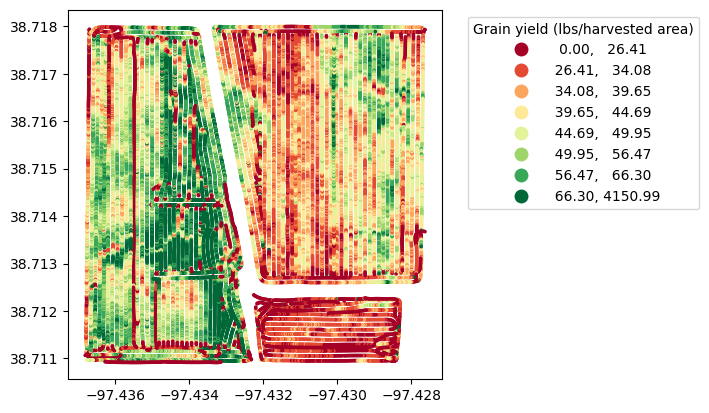

In [9]:
# Visualize data
fig, ax = plt.subplots(nrows=1, ncols=1)
gdf.plot(ax=ax,
        column='Yield',
        k=8,
        scheme='quantiles',
        cmap='RdYlGn',
        legend=True,
        marker='.',
        markersize=10,
        legend_kwds={'loc':'upper left', 'bbox_to_anchor':(1.05,1), 'title':'Grain yield (lbs/harvested area)'});

ax.ticklabel_format(useOffset=False)

In [12]:
# Read boundaries of the file 
bnd = gpd.read_file('../datasets/shapefiles/Mortimers/mortimer_bnd.geojson')
bnd.head()

,geometry
0,"POLYGON ((-97.43696 38.71800, -97.43692 38.714..."


In [13]:
# Clip the yield monitor data to field boundaries
gdf = gpd.clip(gdf, bnd['geometry'].iloc[0])
gdf.reset_index(drop=True, inplace=True)
gdf.head()


,GrowerName,FieldName,CrpZnName,Load,Variety,LoadVar,MachineID,TimeStamp,Date,Time,Yield,Flow,Moisture,Duration,Distance,Width,Area,geometry,Speed
0,Knopf Farms,Mortimer's,Soybeans,11,NaN,11,222486,2017-10-02 11:44:21,2017-10-02,11:44:21,5.21,0.7464,13.0,1.0,68.8189,480.0,0.005266,POINT (-97.43575 38.71092),3.899738
1,Knopf Farms,Mortimer's,Soybeans,11,NaN,11,222486,2017-10-02 11:44:20,2017-10-02,11:44:20,6.94,0.9996,13.0,1.0,69.1732,480.0,0.005293,POINT (-97.43573 38.71092),3.919815
2,Knopf Farms,Mortimer's,Soybeans,11,NaN,11,222486,2017-10-02 11:44:23,2017-10-02,11:44:23,6.07,0.8866,13.0,1.0,70.0787,480.0,0.005363,POINT (-97.43579 38.71092),3.971126
3,Knopf Farms,Mortimer's,Soybeans,11,NaN,11,222486,2017-10-02 11:44:22,2017-10-02,11:44:22,4.22,0.6124,13.0,1.0,69.7244,480.0,0.005336,POINT (-97.43577 38.71092),3.951049
4,Knopf Farms,Mortimer's,Soybeans,11,NaN,11,222486,2017-10-02 11:44:19,2017-10-02,11:44:19,7.09,1.0478,13.0,1.0,70.9449,480.0,0.005429,POINT (-97.43571 38.71092),4.020211


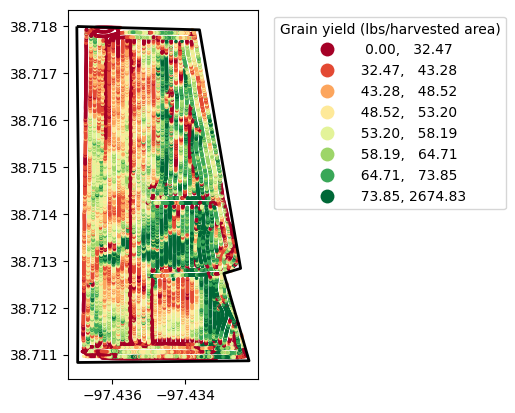

In [14]:
# Visualize data
fig, ax = plt.subplots(nrows=1, ncols=1)
gdf.plot(ax=ax,
        column='Yield',
        k=8,
        scheme='quantiles',
        cmap='RdYlGn',
        legend=True,
        marker='.',
        markersize=10,
        legend_kwds={'loc':'upper left', 'bbox_to_anchor':(1.05,1), 'title':'Grain yield (lbs/harvested area)'});

bnd.plot(ax=ax, linewidth=2, facecolor='None', edgecolor='k')

ax.ticklabel_format(useOffset=False)



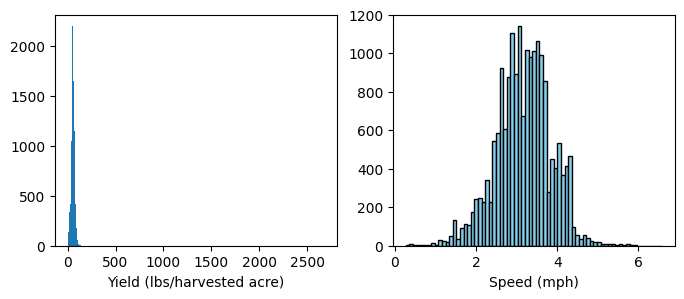

In [15]:
# Create histograms of yield and speed
plt.figure(figsize=(8,3))

plt.subplot(1,2,1)
plt.hist(gdf['Yield'], bins='scott')
plt.xlabel('Yield (lbs/harvested acre)')

plt.subplot(1,2,2)
plt.hist(gdf['Speed'], bins='scott', edgecolor='k', color='skyblue')
plt.xlabel('Speed (mph)')

plt.show()


In [20]:
# Create a function to apply the IQR method for detecting outliers

def iqr_fn(y):
    '''Function to compute the IQR'''
    quantiles = [0.25, 0.75]
    q1,q3 = y.quantile(quantiles)
    iqr = q3 - q1
    idx_outliers = (y < q1-1.5*iqr) | (y > q3+1.5*iqr)
    return idx_outliers


In [21]:
# Use our function to find outliers
idx_yield = iqr_fn(gdf['Yield'])
idx_speed = iqr_fn(gdf['Speed'])

idx_all_outliers = idx_yield | idx_speed
gdf.loc[idx_all_outliers, 'Yield'] = np.nan


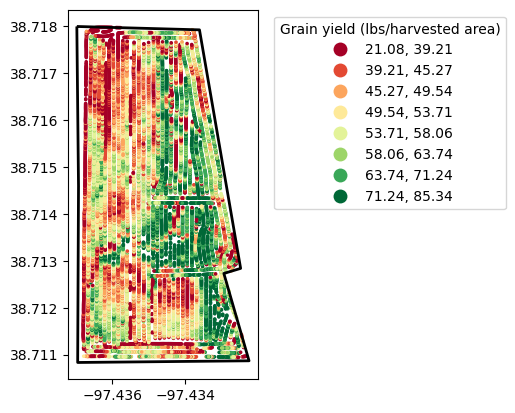

In [22]:
# Visualize data
fig, ax = plt.subplots(nrows=1, ncols=1)
gdf.plot(ax=ax,
        column='Yield',
        k=8,
        scheme='quantiles',
        cmap='RdYlGn',
        legend=True,
        marker='.',
        markersize=10,
        legend_kwds={'loc':'upper left', 'bbox_to_anchor':(1.05,1), 'title':'Grain yield (lbs/harvested area)'});

bnd.plot(ax=ax, linewidth=2, facecolor='None', edgecolor='k')

ax.ticklabel_format(useOffset=False)


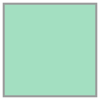

In [23]:
# Learn what the box function does
box(0,0, 10, 10)

In [24]:
# Specify coordinate reference systems
epsg_utm = 32614 # UTM Zone 14
epsg_wgs = 4326 # WGS84


In [42]:
# Define boxes of the field
xmin, ymin, xmax, ymax = bnd.to_crs(epsg=epsg_utm).total_bounds

# Define box size
xdelta = 20 # meters
ydelta = 20 # meters

# Create an empty numpy array
grid = np.array([])

# Iterate to create each box
for x in np.arange(xmin,xmax,xdelta):
    for y in np.arange(ymin,ymax,ydelta):
        cell = box(x, y, x+xdelta, y+ydelta)
        grid = np.append(grid, cell)
        
# Conver the grid to a GeoDataFrame
gdf_grid = gpd.GeoDataFrame(grid, columns=['geometry'], crs=epsg_utm)

# Get centroids of each cell
gdf_grid['centroids'] = gdf_grid['geometry'].centroid

gdf_grid.head()

,geometry,centroids
0,"POLYGON ((635905.410 4285847.629, 635905.410 4...",POINT (635895.410 4285857.629)
1,"POLYGON ((635905.410 4285867.629, 635905.410 4...",POINT (635895.410 4285877.629)
2,"POLYGON ((635905.410 4285887.629, 635905.410 4...",POINT (635895.410 4285897.629)
3,"POLYGON ((635905.410 4285907.629, 635905.410 4...",POINT (635895.410 4285917.629)
4,"POLYGON ((635905.410 4285927.629, 635905.410 4...",POINT (635895.410 4285937.629)


In [43]:
# Change CRS
gdf_grid['geometry'] = gdf_grid['geometry'].to_crs(epsg=epsg_wgs)
gdf_grid['centroids'] = gdf_grid['centroids'].to_crs(epsg=epsg_wgs)

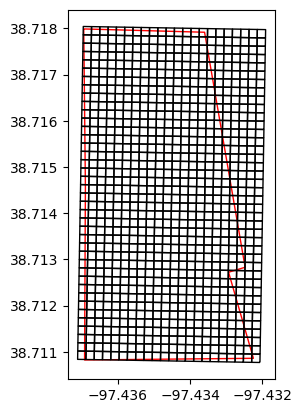

In [44]:
# Create plot of field boundary and grid
fig, ax = plt.subplots(1,1)
bnd.plot(ax=ax, facecolor='w', edgecolor='r')
gdf_grid.plot(ax=ax, facecolor='None', edgecolor='k')
ax.ticklabel_format(useOffset=False)
plt.show()


In [45]:
# Clip cells to field boundary
gdf_grid = gpd.clip(gdf_grid, bnd['geometry'].iloc[0])
gdf_grid.reset_index(drop=True, inplace=True)


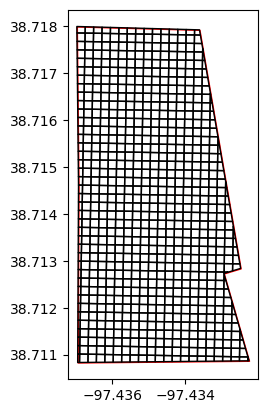

In [46]:
# Create plot of field boundary and grid
fig, ax = plt.subplots(1,1)
bnd.plot(ax=ax, facecolor='w', edgecolor='r')
gdf_grid.plot(ax=ax, facecolor='None', edgecolor='k')
ax.ticklabel_format(useOffset=False)
plt.show()

In [47]:
# Iterate over each cell to compute the median yield
grid_yield = []
for k,row in gdf_grid.iterrows():
    idx_within_cell = gdf['geometry'].within(row['geometry'])
    yield_value = gdf.loc[idx_within_cell, 'Yield'].median()
    grid_yield.append(yield_value)
    
# Append new column to the gdf_grid 
gdf_grid['yield'] = grid_yield
gdf_grid.head()


,geometry,centroids,yield
0,"POLYGON ((-97.43229 38.71095, -97.43229 38.710...",POINT (-97.43217 38.71086),NaN
1,"POLYGON ((-97.43252 38.71095, -97.43229 38.710...",POINT (-97.43240 38.71086),NaN
2,"POLYGON ((-97.43229 38.71095, -97.43229 38.710...",POINT (-97.43217 38.71104),NaN
3,"POLYGON ((-97.43229 38.71095, -97.43252 38.710...",POINT (-97.43240 38.71104),36.565
4,"POLYGON ((-97.43251 38.71113, -97.43251 38.711...",POINT (-97.43240 38.71122),53.040


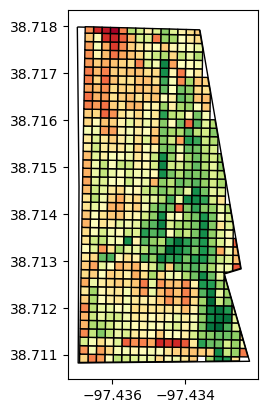

In [48]:
# Create plot of field boundary and grid
fig, ax = plt.subplots(1,1)
bnd.plot(ax=ax, facecolor='w', edgecolor='k')
gdf_grid.plot(ax=ax, column='yield', edgecolor='k', cmap='RdYlGn')
ax.ticklabel_format(useOffset=False)
plt.show()

In [49]:
# CLustering using K-Means
from sklearn.cluster import KMeans

gdf_grid.dropna(inplace=True)
kmeans_info = KMeans(n_clusters=3, n_init='auto').fit(gdf_grid['yield'].values.reshape(-1,1))
gdf_grid['zone'] = kmeans_info.labels_.flatten()
gdf_grid.head()


,geometry,centroids,yield,zone
3,"POLYGON ((-97.43229 38.71095, -97.43252 38.710...",POINT (-97.43240 38.71104),36.565,2
4,"POLYGON ((-97.43251 38.71113, -97.43251 38.711...",POINT (-97.43240 38.71122),53.040,0
5,"POLYGON ((-97.43251 38.71131, -97.43250 38.711...",POINT (-97.43239 38.71140),46.680,2
7,"POLYGON ((-97.43275 38.71096, -97.43252 38.710...",POINT (-97.43263 38.71087),47.360,2
8,"POLYGON ((-97.43298 38.71096, -97.43275 38.710...",POINT (-97.43286 38.71087),75.450,1


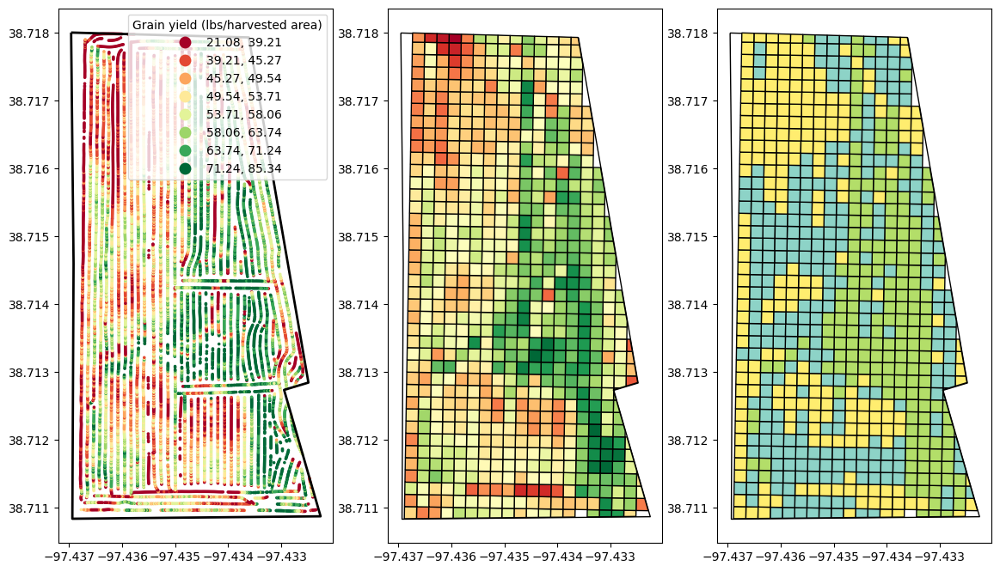

In [50]:
# Visualize the management zones
# Create plot of field boundary and grid
fig, ax = plt.subplots(1,3, figsize=(14,12))

gdf.plot(ax=ax[0],
        column='Yield',
        k=8,
        scheme='quantiles',
        cmap='RdYlGn',
        legend=True,
        marker='.',
        markersize=10,
        legend_kwds={'title':'Grain yield (lbs/harvested area)'});
bnd.plot(ax=ax[0], linewidth=2, facecolor='None', edgecolor='k')

bnd.plot(ax=ax[1], facecolor='w', edgecolor='k')
gdf_grid.plot(ax=ax[1], column='yield', edgecolor='k', cmap='RdYlGn')

bnd.plot(ax=ax[2], facecolor='w', edgecolor='k')
gdf_grid.plot(ax=ax[2], column='zone', edgecolor='k', cmap='Set3')

ax[0].ticklabel_format(useOffset=False)
ax[1].ticklabel_format(useOffset=False)
ax[2].ticklabel_format(useOffset=False)

plt.show()

In [34]:
# Create interactive map
m = gdf.explore(column='Yield', cmap='RdYlGn', tooltip='Yield',popup=True,
           tiles="CartoDB positron",
           style_kwds=dict(color="None", fillOpacity=1.0), # use black outline
           tooltip_kwds=dict(aliases=['Yield (%)'])
           )
m